<a href="https://colab.research.google.com/github/Aidan4478D/ECE414/blob/main/ECE414_Assignment_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Assignment 1: The Santa Fe "Digital Twin" Feasibility Study
## ECE414 - Fundamentals of Remote Sensing and Earth Observation
- Contact: Teams chat
- Submit to: krishna.karra@gmail.com
- *Assigned: Wednesday, February 4 2026*
- *Due: Friday, February 20 2026 (midnight EST)*

## Motivation & Background
Flag_of_New_Mexico.svg

You are a newly hired geospatial data science consultant for the Land of Enchantment, the great state of New Mexico. The governor's office is funding a new digital initiative, focused on developing and proving out geospatial capabilities with satellite imagery. The ultimate goal is to monitor land use changes, enforce water rights, analyze climatic conditions over time and more.

A geospatial consultant was hired in late 2019 to analyze satellite imagery over Santa Fe. After COVID hit and all work went remote, it was slowly discovered that the consultant hadn't made any tangible progress with the data and was delinquent in delivering the necessary reports. This consultant was fired in late 2020, and the work was never picked up again. In 2026, funding has resumed for this initiative, and you have been hired to pick up the task.

The client left behind a stack of raw data and a promise to the government that the data was ready for "immediate analysis". A GIS analyst in the government attempted to run a simple analysis and failed. Your goal as a geospatial data scientist is to make sense of this data and ultimately deliver a report to the governor's office on the utility of this data for the state.

The specifics of what needs to be included in your analysis and report is outlined below. There are two "customers" of your deliverable: (1) the "technical client" e.g. the GIS analyst who has some familiarity with data and interpreting results, and (2) the "business client" e.g. a lawmaker who is only interested in the final products of what you produce.

## Problem Overview
In this problem, you will be analyzing and processing imagery from ESA's Sentinel-2 satellite captured over the greater Santa Fe metro area from 2019 to 2020.

There is a .zip file that contains the contents of this dataset in GeoTIFF format. Each GeoTIFF file contains seven spectral bands, in the following order: (1) red, (2) green, (3) blue, (4) nir, (5) swir1, (6) swir2, and (7) alpha. Note the alpha band represents valid areas in each scene.

## Part 1
The first thing the technical client tried to do was load all the images into a Python datacube to look at the average color of Santa Fe.

*"I tried to stack these images into a numpy array but the code errored out complaining about shape mismatches. I tried visualizing some of the data but it looked all black. Can you help us correct and standardize this data so it's easier to analyze?*

For the technical client, you need to provide a new dataset (all the files can be placed in a .zip file) that they can plug into their existing verification code. For the business client, they need visual and written evidence of the processing steps you took, and what this imagery even looks like, to help them justify keeping you on payroll.

## Part 2
The technical client successfully averaged your corrected stack, but they were unhappy with the results.

*"The average map looks super ghosty, washed out and not at all like what I expected. I animated all the frames and noticed weird black bars flickering in and out of some images. There's clearly some bad data in here, we need a way to only analyze the valid land data.*

You need to devise an approach to figure out which pixels are suitable for analysis in this stack of imagery. The technical client needs to have a way to, for every scene, have a "validity mask" along with the satellite image to figure out which pixels are useful. The business client needs to have this well-documented as part of the report to understand the nuances and limitations of satellite imagery in general.

The technical client had a note with regards to clouds in the imagery:

*"I tried applying a threshold in the nir infrared band to detect clouds which seemed to sort of work, but it had a lot of false positives and missed clouds.*

Neither the technical client or business client are expecting perfection, but they are expecting meaningful progress and a well-documented, automated approach.

## Part 3
As part of the funding of this initiative, the government wants to measure how well satellite imagery can track major environmental and weather-related events using satellite data. To this end, they want you to use satellite imagery to determine, for 2019:

1. When the most snowfall happened
2. When the city had the highest fuel load (wildfire risk)
3. When the city was the driest

The business client expects a date for each one of these, along with a time window that can be inferred from the date. The technical client needs to be able to reproduce your analysis in order to answer follow-up questions using the methods you develop.

Note that the technical client is interested in answering these questions with remote sensing indices that measure standard proxies of vegetation and water. The business client is interested in understanding the limitations that standard remote sensing poses when trying to answer these complex questions.

## Part 4
The government plans to use this digital initiative to foster tourism to Santa Fe and inspire awe about the high desert landscape.

To this end, the business client wants three specific maps to plaster on the walls inside city hall:

1. The Toursim Map - *"We need a picture of Santa Fe that looks like a sunny summer day, with zero clouds and no snow. It needs to look natural but beautiful."*
2. The Fire Risk Map - *"We need a map that assumes the worst case scenario for biomass. It needs to show the absolute greenest point in every place across the year."*
3. The Ski Map - *"Show us the maximum extent of the snowpack for the entire year on one image."*

The business client expects ready-to-print maps for each of these scenarios. Once again, the technical client needs to be able to recreate these maps and possibly make more versions of them in the future.

# Helpful Tips

1. Environment Setup
- **Notebook Ownership:** Create a copy of the original Colaboratory notebook and save it to your personal or university Google Drive.
- **Compute Resources:** As the dataset and processing tasks can be memory-intensive, ensure you are utilizing Colab Pro or a local machine with sufficient processing power to avoid session crashes.

2. Structure & Organization
- **Logical Flow:** Organize the notebook strictly according to the four parts outlined in the assignment.
- **Modular Code:** Use functions for repetitive tasks, such as plotting or index calculation, rather than copy pasting the same code over and over again
- **Intermediate Checkpoints:** It is highly recommended to save the output of Part 1 (the cleaned/masked data) as intermediate files to manage RAM usage more efficiently.

3. Documentation & Analysis
- **Not just "How", but "Why"**: Include Markdown cells explaining your technical choices—for example, why you chose a specific threshold for cloud masking or how you handled coordinate system mismatches.
- **Insightful Commentary:** Discuss any anomalies you find in the Santa Fe dataset, such as the "black bars" or "ghosty" artifacts mentioned by the technical client.

4. Final Delivery
- **Sharing Settings:** Share the notebook with the instructor (krishna.karra@gmail.com) and ensure the permissions are set to "Commenter" so feedback can be provided directly on your work.
- Deadline: Ensure all files and the notebook link are submitted before Friday, February 20, 2026, at midnight EST.

# Data access
The code below should get you started with downloading the dataset to your colab environment and installing the necessary Python packages. You are expected to use other libraries and GIS software as necessary to complete the assignment.

The dataset can also be downloaded locally to your machine from this [link](https://drive.google.com/file/d/17vcid-djDTh0lrTF6VJy_oMcwSc7md1z/view?usp=sharing).

In [28]:
!wget https://storage.googleapis.com/krishna-skytruth-dev/ece471/homework_1/s2_santafe.zip
!unzip -oq s2_santafe.zip

--2026-02-22 21:52:34--  https://storage.googleapis.com/krishna-skytruth-dev/ece471/homework_1/s2_santafe.zip
Resolving storage.googleapis.com (storage.googleapis.com)... 192.178.155.207, 192.178.218.207, 142.250.31.207, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|192.178.155.207|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 3327331282 (3.1G) [application/zip]
Saving to: ‘s2_santafe.zip’

s2_santafe.zip      100%[===================>]   3.10G   182MB/s    in 19s     

2026-02-22 21:52:53 (166 MB/s) - ‘s2_santafe.zip’ saved [3327331282/3327331282]



In [29]:
!ls s2_santafe/

sentinel-2:L1C_2018-01-07.tif  sentinel-2:L1C_2018-07-18.tif
sentinel-2:L1C_2018-01-12.tif  sentinel-2:L1C_2018-07-21.tif
sentinel-2:L1C_2018-01-14.tif  sentinel-2:L1C_2018-07-23.tif
sentinel-2:L1C_2018-01-27.tif  sentinel-2:L1C_2018-07-26.tif
sentinel-2:L1C_2018-01-29.tif  sentinel-2:L1C_2018-07-28.tif
sentinel-2:L1C_2018-02-08.tif  sentinel-2:L1C_2018-07-31.tif
sentinel-2:L1C_2018-02-11.tif  sentinel-2:L1C_2018-08-02.tif
sentinel-2:L1C_2018-02-13.tif  sentinel-2:L1C_2018-08-05.tif
sentinel-2:L1C_2018-02-18.tif  sentinel-2:L1C_2018-08-07.tif
sentinel-2:L1C_2018-02-21.tif  sentinel-2:L1C_2018-08-10.tif
sentinel-2:L1C_2018-02-23.tif  sentinel-2:L1C_2018-08-12.tif
sentinel-2:L1C_2018-02-28.tif  sentinel-2:L1C_2018-08-17.tif
sentinel-2:L1C_2018-03-03.tif  sentinel-2:L1C_2018-08-20.tif
sentinel-2:L1C_2018-03-10.tif  sentinel-2:L1C_2018-08-25.tif
sentinel-2:L1C_2018-03-13.tif  sentinel-2:L1C_2018-08-27.tif
sentinel-2:L1C_2018-03-15.tif  sentinel-2:L1C_2018-09-04.tif
sentinel-2:L1C_2018-03-2

In [30]:
!ls s2_santafe/ | wc -l

102


In [ ]:
!pip install rasterio

# Part 1

In [98]:
from affine import loadsw
from osgeo import gdal
import rasterio

import numpy as np
import matplotlib.pyplot as plt

import rasterio.features
import rasterio.warp

"""
The raw satellite images currently look pitch black to our eyes because
satellites capture light outside of normal human perception. This section builds
tools to "stretch" the light values so they look like normal beautiful photos.
We also ensure we only look at valid data, ignoring the black portions of the
satellite image.
"""

# This function applies a percentile-based linear contrast stretch.
# band: 2D numpy array of a single spectral band.
# mask: boolean array where True = valid data (alpha > 0).
# margin: percentile to clip (e.g., 2nd and 98th) to ignore extreme bright/dark
#   outliers.
def stretch(band, mask, margin=2, epsilon=1e-6):
    vals = band[mask]

    # used percentiles over min/max as the latter are often dominated by outliers
    low_2 = np.percentile(vals, margin)
    high_2 = np.percentile(vals, 100-margin)

    # clip normalized values between 0 and 1, add epsilon to avoid div by 0 when low_2 = high_2
    return np.clip((band - low_2) / (high_2 - low_2 + epsilon), 0, 1)


# Helper function to extract and visualize the visible spectrum (RGB).
def show_fixed_rgb(path, title=None, contrast_stretch=False):
    with rasterio.open(path) as src:
        img = src.read()

        # extract R, G, B & alpha bands and make sure they're the right format
        R, G, B = img[0].astype(np.float32), img[1].astype(np.float32), img[2].astype(np.float32)

        # # valid data mask as bool vector
        alpha = img[6] > 0

    # allow both raw and contrast stretched photos
    if contrast_stretch:
        rgb = np.dstack([
            stretch(R, alpha),
            stretch(G, alpha),
            stretch(B, alpha),
        ])
    else:
        rgb = np.dstack([
            R,
            G,
            B,
        ])

    plt.figure(figsize=(7,7))
    plt.imshow(rgb)
    plt.axis("off")
    plt.title(title if title else path.split("/")[-1])
    plt.show()

Found: 3
['/content/s2_santafe/sentinel-2:L1C_2018-01-07.tif', '/content/s2_santafe/sentinel-2:L1C_2018-01-12.tif']
Original images


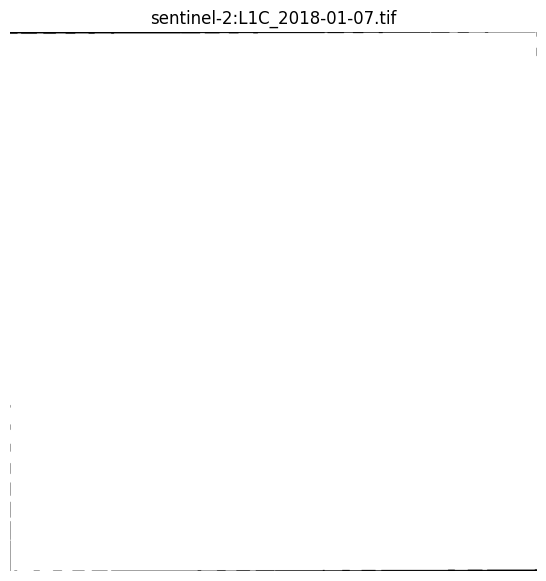

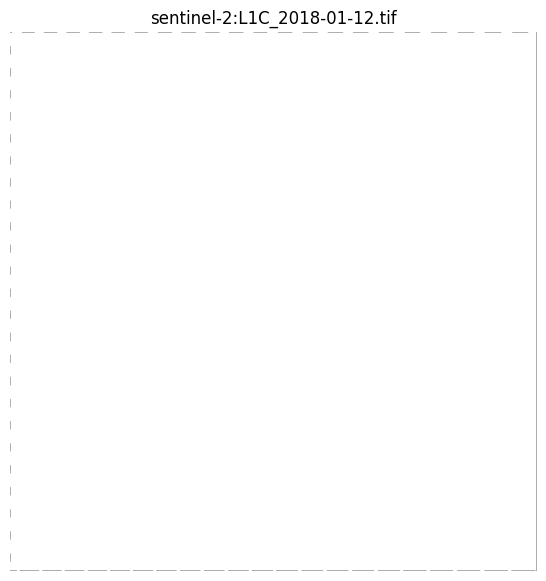

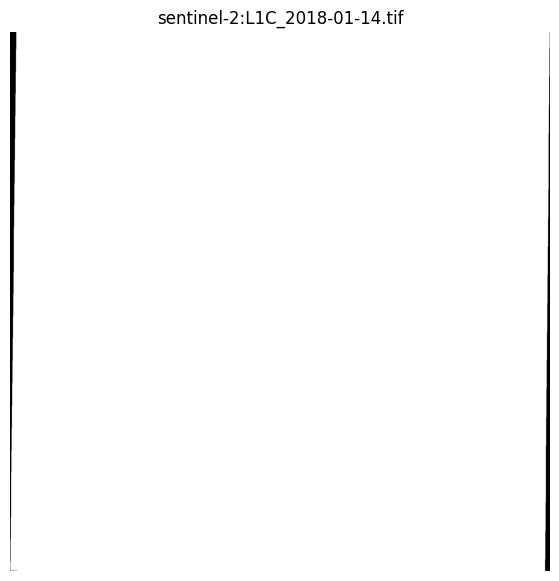

Modified images


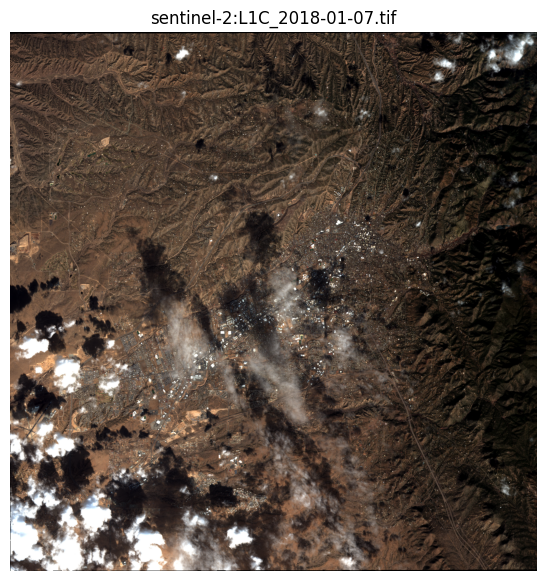

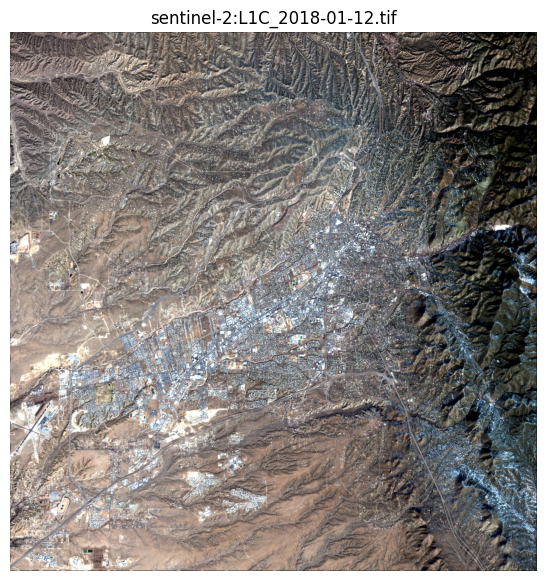

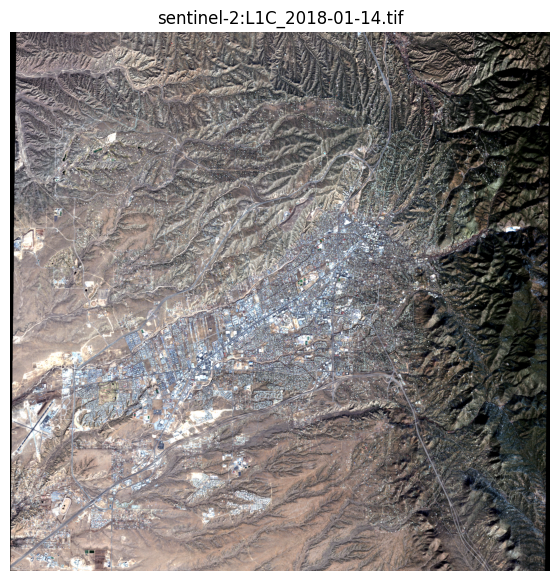

In [107]:
import matplotlib.pyplot as plt
from glob import glob

"""
This block tests if the show_fixed_rgb helper works as intended, and properly
displays the images.
"""

# number of images to show
show = 3
test = sorted(glob(os.path.join("/content/s2_santafe", "*.tif")))[:show]

print("Found:", len(test))
print(test[:2])

print("Original images")
for t in test:
    show_fixed_rgb(t, contrast_stretch=False)

print("Modified images")
for t in test:
    show_fixed_rgb(t, contrast_stretch=True)

In [102]:
import os
from glob import glob
from collections import Counter

import numpy as np
import rasterio
from rasterio.warp import reproject, Resampling, transform_bounds
from rasterio.transform import Affine

"""
The previous consultant left us with images that aren't all the same. Some are
shifted, some have different resolutions, and they use different coordinate
reference systems (CRS).

To track changes over time, we have to force all the images to share the exact
same spatial boundaries and map projection.

This code calculates the mathematical intersection of every image and standardizes
them into a uniform "datacube" so we can analyze them stack-by-stack.
"""

# input directory to take files from and output directory to save reprojected files to
INPUT_DIR  = "/content/s2_santafe"
OUTPUT_DIR = "/content/s2_santafe_fixed_reproj"
os.makedirs(OUTPUT_DIR, exist_ok=True)

files = sorted(glob(os.path.join(INPUT_DIR, "*.tif")))
print("Found:", len(files))

# Scans all input GeoTIFFs to find the most frequently used CRS. Used to prevent
# unnecessary reprojection of the entire dataset.
def most_common_crs(paths):
    crs_strs = []
    for p in paths:
        with rasterio.open(p) as src:
            if src.crs is not None:
                crs_strs.append(src.crs.to_string())
    if not crs_strs:
        raise RuntimeError("No CRS found in inputs.")

    counts = Counter(crs_strs)
    crs_str, n = counts.most_common(1)[0]

    return rasterio.crs.CRS.from_string(crs_str), counts

# Finds the maximum common overlapping bounding box across all scenes.
# dst_crs: The target CRS. Densifies points during transform_bounds to account
#          for non-linear edge curvature during CRS reprojection.
def intersect_bounds_in_crs(paths, dst_crs):
    L, B, R, T = -np.inf, -np.inf, np.inf, np.inf

    # loop through files
    for p in paths:
        with rasterio.open(p) as src:

            # transform crs if path crs is not the same as the dst_crs
            if src.crs == dst_crs:
                left, bottom, right, top = src.bounds
            else:
                left, bottom, right, top = transform_bounds(
                    src.crs, dst_crs, *src.bounds, densify_pts=21
                )

        # maximize the lower bounds and minimize the upper bounds to find the intersection
        L = max(L, left)
        B = max(B, bottom)
        R = min(R, right)
        T = min(T, top)

    # raise error if bounds do not make sense (Left < Right, or Top < Bottom)
    if R <= L or T <= B:
        raise RuntimeError("Intersection is empty (no common overlap).")

    return (L, B, R, T)


# To stack images over time, we need to ensure every single pixel across all
# images represents the exact same square of dirt in Santa Fe.
# This function builds a "mapping matrix" (Affine transform). You can think of it
# as placing a GPS coordinate on the top-left corner of the image and defining
# exactly how big each pixel is in meters. This guarantees that when we look at
# pixel (10, 10) in January and pixel (10, 10) in July, we are looking at the
# exact same patch of land.
def grid_from_intersection(bounds, pixel_size):
    left, bottom, right, top = bounds
    xres, yres = pixel_size  # yres positive from rasterio src.res but transform uses negative y step

    # enforce North-up affine (0.0 rotation, straight up-and-down grid)
    dst_transform = Affine(xres, 0.0, left, 0.0, -yres, top)

    # calculate exactly how many pixels fit inside our bounding box
    # using integer division so we don't end up with fractional pixels.
    width  = int((right - left) / xres)
    height = int((top - bottom) / yres)

    # shrink right/bottom to match integer pixels exactly (keeps inside intersection)
    # this ensures our final grid doesn't accidentally stretch past our actual data.
    right_snap  = left + width * xres
    bottom_snap = top - height * yres

    return dst_transform, width, height, (left, bottom_snap, right_snap, top)


# pick target CRS to be the most common CRS
target_crs, crs_counts = most_common_crs(files)
print("CRS counts:", dict(crs_counts))
print("Target CRS:", target_crs.to_string())

# choose a representative pixel size (from a file already in target CRS)
pixel_size = None
for p in files:
    with rasterio.open(p) as src:
        if src.crs == target_crs:
            pixel_size = src.res
            break
if pixel_size is None:
    raise RuntimeError("No file in target CRS found (unexpected).")

# intersection grid
raw_bounds = intersect_bounds_in_crs(files, target_crs)
dst_transform, dst_width, dst_height, snapped_bounds = grid_from_intersection(raw_bounds, pixel_size)

print(f"Target grid: {dst_height} x {dst_width} pixels")
print("Pixel size:", pixel_size)
print("Snapped bounds:", tuple(round(v, 2) for v in snapped_bounds))

"""
With the common grid established, we now run every raw image through a cleaner.
This scales the raw sensor data into standard "reflectance" values (0 to 1)
and physically warps the image into our new master grid. We compress the outputs
to save disk space. This guarantees the GIS team can simply stack these files
and run algorithms without failing.
"""

for i, p in enumerate(files, 1):
    with rasterio.open(p) as src:
        cube = src.read().astype(np.float32)  # (7,H,W)

        # Sentinel-2 data typically stores surface reflectance as integer
        # "Digital Numbers" (DN) scaled by 10,000 to save space. Thus, here we
        # divide by 10000.0 to return to actual reflectance percentages (0.0 to 1.0)
        # and clip any sensor anomalies to stay strictly within that bound.
        cube[:6] = np.clip(cube[:6] / 10000.0, 0, 1)
        cube[6] = (cube[6] > 0).astype(np.float32)

        # convert the alpha band (band 7) into a strict 1.0 (valid) or 0.0 (invalid) mask.
        out = np.zeros((7, dst_height, dst_width), np.float32)

        # Resampling strategy .
        # - bands 0-5 (Spectral Reflectance): bilinear resampling averages nearby
        #   pixels during warping, preserving a smooth, continuous image.
        #
        # - Band 6 (Alpha Mask): Nearest Neighbor ensures we only get exact 1s or 0s.
        #   If we used Bilinear here, we'd get "half-valid" fuzzy edges (e.g., 0.5)
        #   which would break boolean logic down the line.
        for bi in range(7):
            resamp = Resampling.bilinear if bi < 6 else Resampling.nearest
            reproject(
                source=cube[bi],
                destination=out[bi],
                src_transform=src.transform,
                src_crs=src.crs,
                dst_transform=dst_transform,
                dst_crs=target_crs,
                resampling=resamp,
            )

        # update metadata so the resulting GeoTIFF knows its new shape, location, and CRS grid.
        meta = src.meta.copy()
        meta.update(
            driver="GTiff",
            height=dst_height,
            width=dst_width,
            count=7,
            crs=target_crs,
            transform=dst_transform,
            dtype="float32",
            compress="deflate", # # Deflate compression significantly reduces file size.
            predictor=3, # Optimized for floating-point raster compression.
        )

    # output file path
    out_name = os.path.basename(p).replace(".tif", "_fixed.tif")
    out_path = os.path.join(OUTPUT_DIR, out_name)

    with rasterio.open(out_path, "w", **meta) as dst:
        dst.write(out)

    print(f"{i}: Reprojected file to {out_path}")

print("Done:", OUTPUT_DIR)

Found: 102
CRS counts: {'EPSG:6528': 34, 'EPSG:3857': 35, 'EPSG:32613': 33}
Target CRS: EPSG:3857
Target grid: 1719 x 1680 pixels
Pixel size: (15.690633957594663, 15.690633957594663)
Snapped bounds: (-11810820.34, 4240966.44, -11784460.08, 4267938.64)
1: Reprojected file to /content/s2_santafe_fixed_reproj/sentinel-2:L1C_2018-01-07_fixed.tif
2: Reprojected file to /content/s2_santafe_fixed_reproj/sentinel-2:L1C_2018-01-12_fixed.tif
3: Reprojected file to /content/s2_santafe_fixed_reproj/sentinel-2:L1C_2018-01-14_fixed.tif
4: Reprojected file to /content/s2_santafe_fixed_reproj/sentinel-2:L1C_2018-01-27_fixed.tif
5: Reprojected file to /content/s2_santafe_fixed_reproj/sentinel-2:L1C_2018-01-29_fixed.tif
6: Reprojected file to /content/s2_santafe_fixed_reproj/sentinel-2:L1C_2018-02-08_fixed.tif
7: Reprojected file to /content/s2_santafe_fixed_reproj/sentinel-2:L1C_2018-02-11_fixed.tif
8: Reprojected file to /content/s2_santafe_fixed_reproj/sentinel-2:L1C_2018-02-13_fixed.tif
9: Reproject

In [103]:
import os
import numpy as np
import rasterio
from glob import glob

"""
This section tests whether or not the reprojection worked as intended.
"""

# Grab the first 5 processed files for a quick sanity check
test_files = sorted(glob(os.path.join(OUTPUT_DIR, "*.tif")))[:5]
print(f"Testing {len(test_files)} files...\n")

datacube = []

for f in test_files:
    with rasterio.open(f) as src:
        print(f"File: {os.path.basename(f)}")
        print(f" - Shape: {src.shape}")
        print(f" - CRS: {src.crs}")

        # We only print the first few elements of the transform for brevity
        print(f" - Transform starts with: {list(src.transform)[:3]}\n")

        # Read all bands and append to our list
        datacube.append(src.read())

# The Ultimate Test: Can NumPy stack them without throwing a ValueError?
try:
    # This will ONLY work if every single array has the exact same dimensions
    stacked_cube = np.array(datacube)
    print("SUCCESS! The files stacked perfectly.")
    print(f"Final Datacube Shape: {stacked_cube.shape} (Time, Bands, Height, Width)")
except ValueError as e:
    print("FAILED! The shapes do not match. Reprojection issue:", e)

Testing 5 files...

File: sentinel-2:L1C_2018-01-07_fixed.tif
 - Shape: (1719, 1680)
 - CRS: EPSG:3857
 - Transform starts with: [15.690633957594663, 0.0, -11810820.344417868]

File: sentinel-2:L1C_2018-01-12_fixed.tif
 - Shape: (1719, 1680)
 - CRS: EPSG:3857
 - Transform starts with: [15.690633957594663, 0.0, -11810820.344417868]

File: sentinel-2:L1C_2018-01-14_fixed.tif
 - Shape: (1719, 1680)
 - CRS: EPSG:3857
 - Transform starts with: [15.690633957594663, 0.0, -11810820.344417868]

File: sentinel-2:L1C_2018-01-27_fixed.tif
 - Shape: (1719, 1680)
 - CRS: EPSG:3857
 - Transform starts with: [15.690633957594663, 0.0, -11810820.344417868]

File: sentinel-2:L1C_2018-01-29_fixed.tif
 - Shape: (1719, 1680)
 - CRS: EPSG:3857
 - Transform starts with: [15.690633957594663, 0.0, -11810820.344417868]

✅ SUCCESS! The files stacked perfectly.
Final Datacube Shape: (5, 7, 1719, 1680) (Time, Bands, Height, Width)


In [79]:
from google.colab import drive
import shutil
import os

# save re-projected files to drive so that they can be reused later without having
# to re-project the original files again
drive.mount('/content/drive')

SRC_DIR = "/content/s2_santafe_fixed_reproj"
DST_DIR = "/content/drive/MyDrive/datasets/ece414_remote_sensing/s2_santafe_fixed_reproj"

shutil.copytree(SRC_DIR, DST_DIR, dirs_exist_ok=True)

'/content/drive/MyDrive/datasets/ece414_remote_sensing/s2_santafe_fixed_reproj'

# Part 2

The technical client successfully averaged your corrected stack, but they were unhappy with the results.

"The average map looks super ghosty, washed out and not at all like what I expected. I animated all the frames and noticed weird black bars flickering in and out of some images. There's clearly some bad data in here, we need a way to only analyze the valid land data.

You need to devise an approach to figure out which pixels are suitable for analysis in this stack of imagery. The technical client needs to have a way to, for every scene, have a "validity mask" along with the satellite image to figure out which pixels are useful. The business client needs to have this well-documented as part of the report to understand the nuances and limitations of satellite imagery in general.

The technical client had a note with regards to clouds in the imagery:

"I tried applying a threshold in the nir infrared band to detect clouds which seemed to sort of work, but it had a lot of false positives and missed clouds.

Neither the technical client or business client are expecting perfection, but they are expecting meaningful progress and a well-documented, automated approach.

In [108]:
import os
import numpy as np
import rasterio
from glob import glob

"""
Satellites take pictures of everything between the lens and the ground, which
frequently includes clouds, haze, and the dark shadows they cast. The "black bars"
seen in previous animations were simply areas outside the satellite's camera path.
If we average these obscured images together, the final map looks "ghosty."

To fix this, we created a "Validity Mask." Think of this as a digital filter that
looks at every single pixel and asks: "Is this a cloud? Is this a shadow?
Is this an empty black edge?" If yes, it removes that pixel from our analysis.
This ensures our final products only use clear views of the Santa Fe landscape.
"""

# directories where data currently is, and where to save the masks to
DATA_DIR = "/content/drive/MyDrive/datasets/ece414_remote_sensing/s2_santafe_fixed_reproj"
MASK_DIR = "/content/drive/MyDrive/datasets/ece414_remote_sensing/s2_santafe_masks"
os.makedirs(MASK_DIR, exist_ok=True)

# helper that calculates the normalized difference between two arrays.
# epsilon is added to the denominator to prevent divide-by-zero errors on completely black pixels.
def nd(a, b, eps=1e-6):
    return (a - b) / (a + b + eps)


# Core heuristic masking function.
# The previous analyst tried to find clouds using just the NIR band, which causes
# massive false positives with bright sand or snow. We solve this by using multiple
# spectral bands to differentiate the unique "fingerprints" of clouds, snow, and land.
def build_valid_mask(img):
    # Get bands & alpha mask
    R, G, B = img[0], img[1], img[2]
    NIR, SWIR1, SWIR2 = img[3], img[4], img[5]
    alpha = img[6] > 0

    # average RGB to calculate brightness
    brightness = (R + G + B) / 3.0

    # Normalized Difference Vegetation index - Healthy plants reflect NIR but absorb Red.
    ndvi = nd(NIR, R)

    # Normalized Difference Snow Index - Snow reflects visible Green light but strongly absorbs Shortwave Infrared (SWIR).
    # Clouds reflect BOTH. This is how we tell snow and clouds apart!
    ndsi = nd(G, SWIR1) # snow tends to have high NDSI

    # Snow is bright, has high NDSI, and reflects some NIR.
    snow = (ndsi > 0.4) & (brightness > 0.25) & (NIR > 0.25)

    # Shadows are exceptionally dark across both visible and NIR bands.
    shadow = (brightness < 0.08) & (NIR < 0.10)

    # 'Whiteness' metric. Clouds are typically "pure white" or grey, meaning their
    # Red, Green, and Blue values are almost identical. A smaller whiteness value
    # means the pixel is closer to pure grey/white.
    whiteness = (np.abs(R - G) + np.abs(R - B) + np.abs(G - B))

    # "thick cloud" - bright + white-ish + not vegetation + moderate SWIR
    cloud_thick = (
        (brightness > 0.30) &
        (whiteness < 0.10) &
        (ndvi < 0.25) &
        (SWIR1 > 0.12)
    )

    # "thin cloud/haze" - slightly less bright but very white-ish and low contrast
    cloud_thin = (
        (brightness > 0.22) &
        (whiteness < 0.07) &
        (ndvi < 0.35) &
        (SWIR1 > 0.08)
    )

    # avoid misclassifying snow as cloud (snow tends to have high NDSI)
    cloud = (cloud_thick | cloud_thin) & ~(ndsi > 0.35)

    # also remove saturated-ish bright pixels (optional)
    snow_like = (ndsi > 0.35) & (brightness > 0.20)   # loose snow proxy

    # Catch-all for extreme sensor saturation, but explicitly excluding snow so we don't accidentally mask out our ski map data.
    very_bright = ((brightness > 0.75) | (R > 0.85) | (G > 0.85) | (B > 0.85)) & (~snow)

    # Valid = NOT cloud AND NOT shadow AND NOT very_bright AND IS inside alpha.
    valid = ~(cloud | shadow | very_bright | (~alpha))

    return valid


"""
Instead of recalculating these complex cloud/shadow rules every time we want to
look at the data, we process them once and save them as standalone "mask" files.
This saves computing time and gives the technical team a clear audit trail.
"""

tifs = sorted(glob(os.path.join(DATA_DIR, "*_fixed.tif")))
print("Found scenes:", len(tifs))

for path in tifs:
    with rasterio.open(path) as src:
        img = src.read().astype(np.float32)
        meta = src.meta.copy()

    # use previously constructed helper to build valid mask
    valid = build_valid_mask(img)

    # change the metadata dtype to uint8 (1 byte per pixel) since boolean masks only need to store 1s and 0s.
    mask_meta = meta.copy()
    mask_meta.update(count=1, dtype="uint8", nodata=0)

    out_mask = os.path.join(MASK_DIR, os.path.basename(path).replace("_fixed.tif", "_validmask.tif"))
    with rasterio.open(out_mask, "w", **mask_meta) as dst:
        dst.write(valid.astype(np.uint8), 1)

print("Wrote masks to:", MASK_DIR)


Found scenes: 102
Wrote masks to: /content/drive/MyDrive/datasets/ece414_remote_sensing/s2_santafe_masks


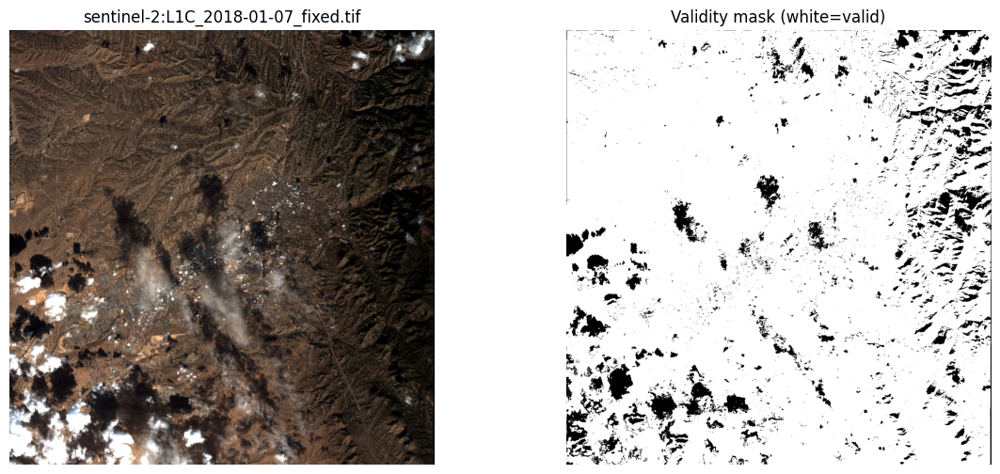

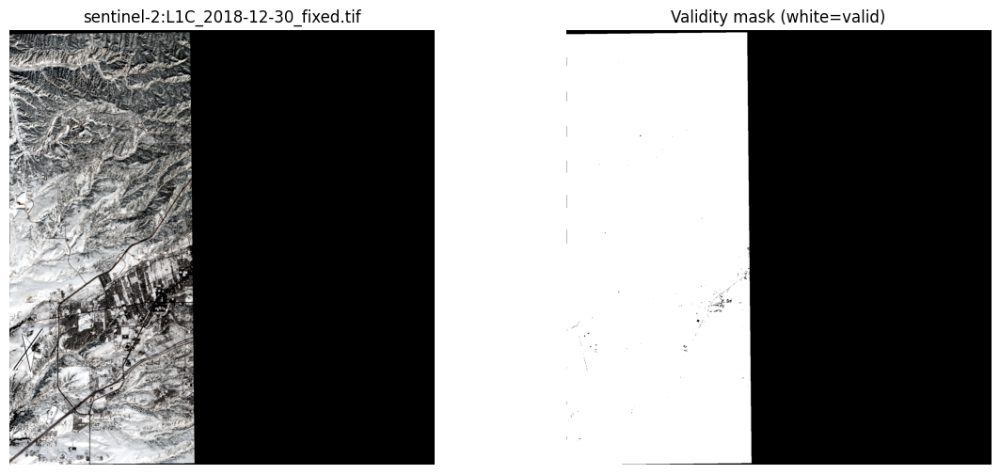

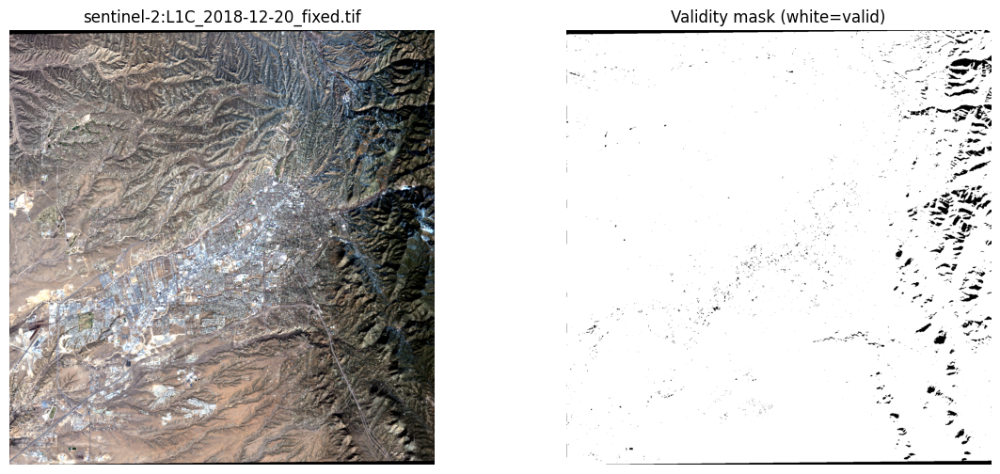

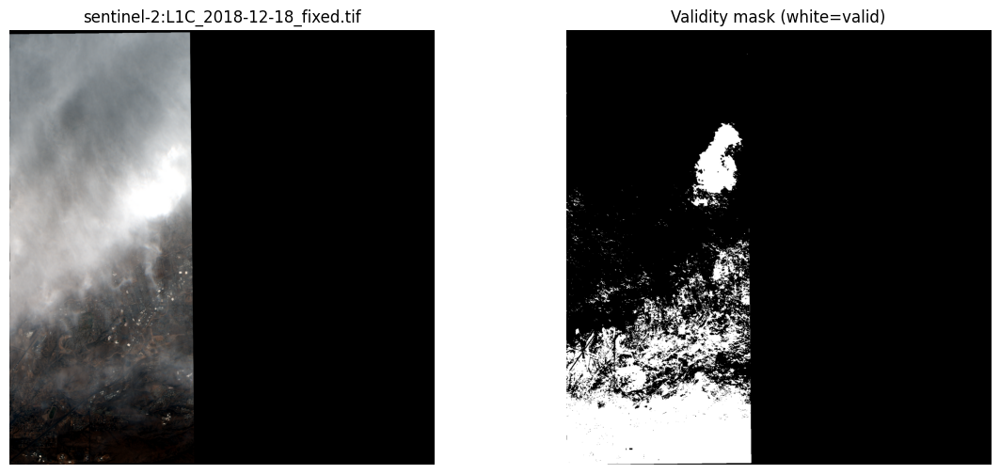

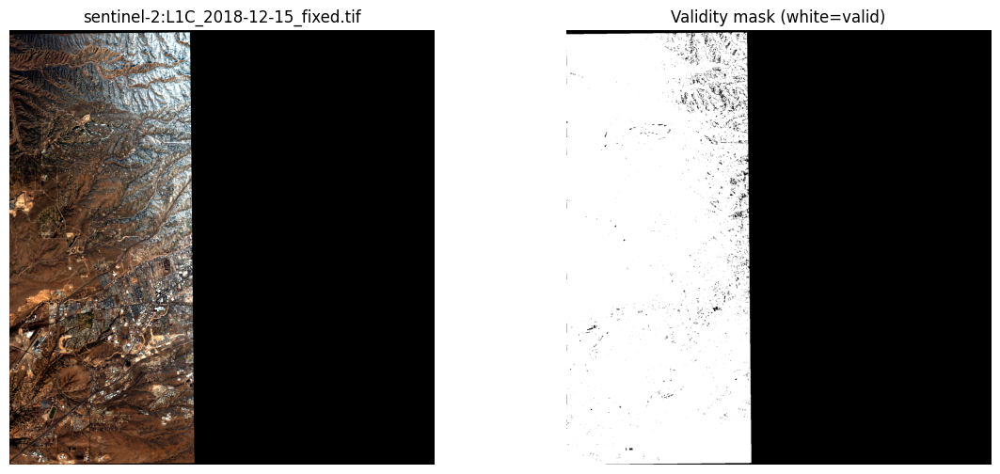

...

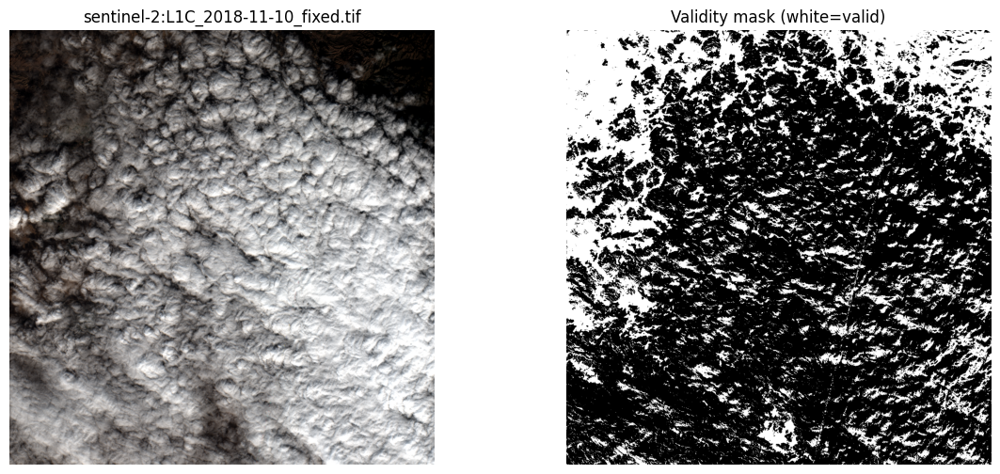

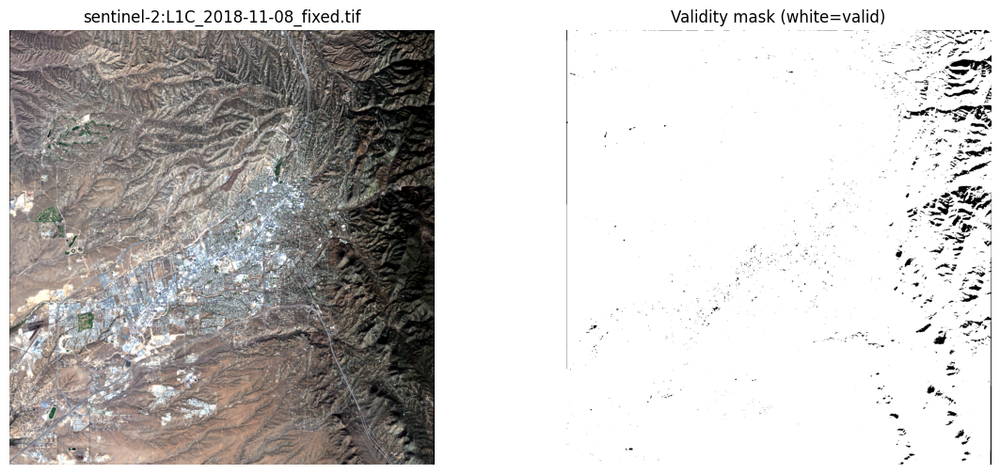

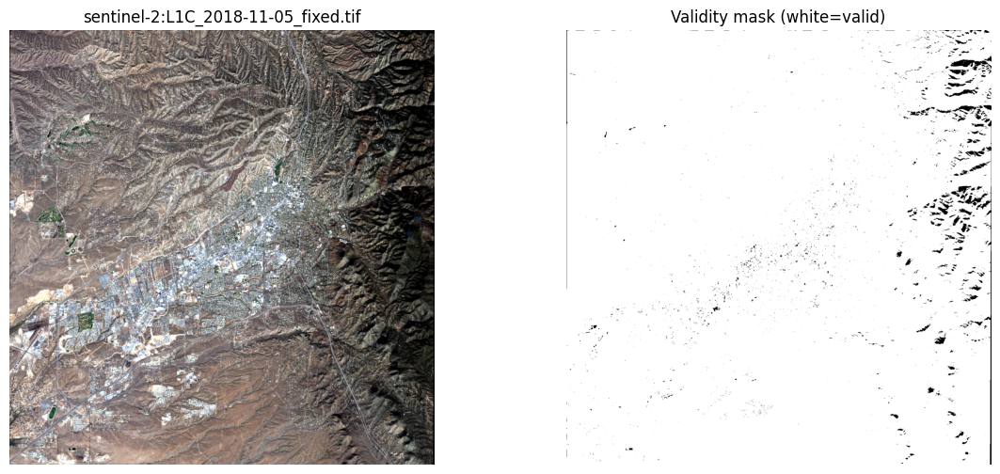

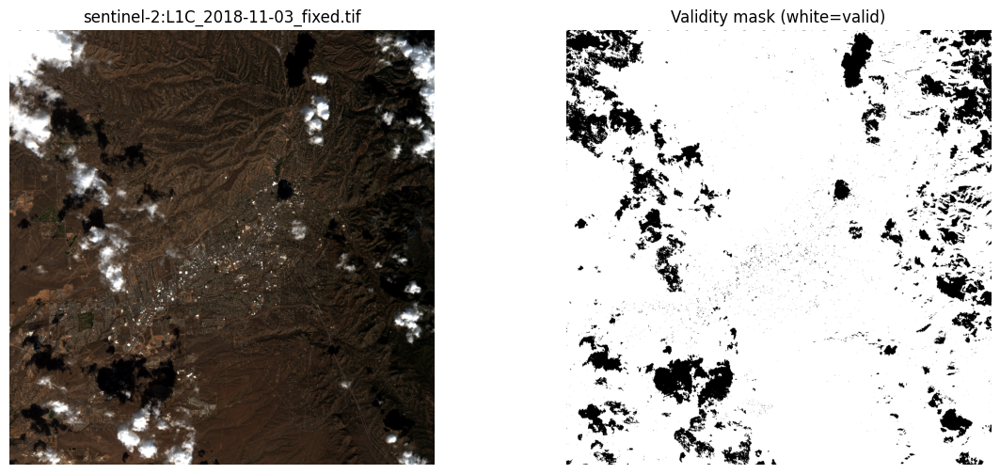

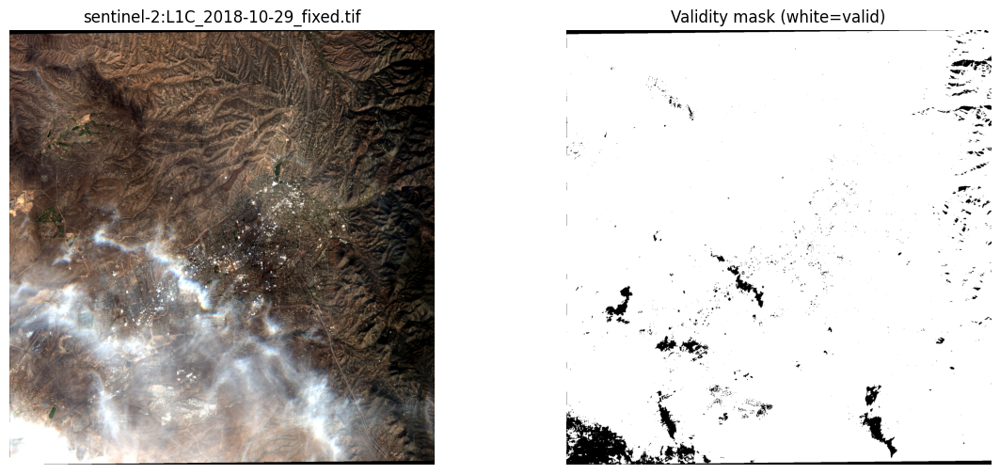

In [109]:
import matplotlib.pyplot as plt

"""
To prove that our validity mask is accurately identifying bad data, we generate
side-by-side comparisons of the raw satellite photos and our new digital masks.
In the right-hand image, white pixels represent "clean" data we will use for
analysis, while black pixels show where the algorithm successfully detected and
removed clouds, shadows, or empty space.

This step ensures transparency and builds trust in the final maps.
"""

# helper function to load the source image and the calculated boolean mask,
# apply a contrast stretch, and plot them side-by-side using matplotlib.
def show_rgb_and_mask(img_path, mask_path, contrast_stretch=True):
    with rasterio.open(img_path) as src:
        img = src.read().astype(np.float32) # load the image as float32 for math operations
    with rasterio.open(mask_path) as m:
        mask = m.read(1).astype(bool) #load the mask as boolean (True = Valid, False = Invalid)

    # extract standard visible bands and the alpha footprint
    R, G, B = img[0], img[1], img[2]
    alpha = img[6] > 0

    # apply the contrast stretch if requested
    if contrast_stretch:
        rgb = np.dstack([
            stretch(R, alpha),
            stretch(G, alpha),
            stretch(B, alpha)
        ])
    else:
        rgb = np.dstack([R, G, B])

    # Force pixels outside the satellite's footprint to be pure black.
    rgb[~alpha] = 0

    # Left subplot: The True Color Image
    plt.figure(figsize=(14,6))
    plt.subplot(1,2,1)
    plt.imshow(rgb)
    plt.title(img_path.split("/")[-1])
    plt.axis("off")

    # # Right subplot: The Boolean Validity Mask
    plt.subplot(1,2,2)
    plt.imshow(mask, cmap="gray")
    plt.title("Validity mask (white=valid)")
    plt.axis("off")
    plt.show()


# Grabbing the last 20 images in the sorted list.
# Because they are chronologically sorted, this gives us a solid sample of
# continuous seasonal conditions to check our thresholds against. I also wanted
# to check how well the mask differentiated between clouds and snow.
for i in range(20):
    img0 = tifs[-i]
    mask0 = os.path.join(MASK_DIR, os.path.basename(img0).replace("_fixed.tif", "_validmask.tif"))
    show_rgb_and_mask(img0, mask0, contrast_stretch=True)


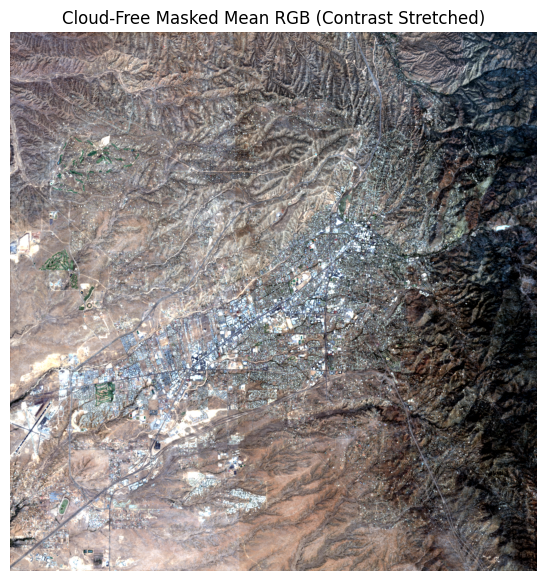

Mean valid coverage: 1.0
Avg #obs per pixel: 88.66439056396484


In [111]:
import numpy as np
import rasterio
from glob import glob
import os
import matplotlib.pyplot as plt

"""
Now that we have successfully identified the bad data (clouds, shadows, etc.),
we can create a clean "Master Average" map of Santa Fe.

Instead of blindly averaging everything, which caused the "ghosty" map the previous
analyst delivered, we only average the pixels that our mask approved. The result
is a beautiful, cloud-free composite of the city.
"""

tifs = sorted(glob(os.path.join(DATA_DIR, "*_fixed.tif")))
masks = [os.path.join(MASK_DIR, os.path.basename(p).replace("_fixed.tif", "_validmask.tif")) for p in tifs]

# use the first image to define the exact spatial dimensions (Height, Width).
with rasterio.open(tifs[0]) as ref:
    ref_h, ref_w = ref.height, ref.width

# Initialize empty arrays for a running sum.
# stacking 100+ high-res images into a single 4D NumPy array all at once would
# likely crash the system (out-of-memory error). A running sum calculates the
# average sequentially, keeping memory usage extremely low.
sum_rgb = np.zeros((3, ref_h, ref_w), np.float32)
count = np.zeros((ref_h, ref_w), np.float32)

# loop through tif files and their respective masks
for p_img, p_m in zip(tifs, masks):
    if not os.path.exists(p_m): # skip if mask doesn't exist
        continue

    # load only the visible light bands (R, G, B) to save memory
    with rasterio.open(p_img) as src:
        rgb = src.read([1,2,3]).astype(np.float32)

    # valid mask
    with rasterio.open(p_m) as msrc:
        valid = (msrc.read(1) > 0)

    # np.where allows us to add the pixel's RGB values ONLY if
    # the 'valid' mask is True. Otherwise, we add 0.0 to the running sum.
    # [None, :, :] broadcasts the 2D boolean mask across all 3 RGB color channels.
    sum_rgb += np.where(valid[None, :, :], rgb, 0.0)

    # keep track of exactly how many valid observations we have for each individual pixel
    count += valid.astype(np.float32)

# Divide the sum by the count to get the true mean.
# np.maximum(..., 1e-6) prevents a Divide-By-Zero error on pixels that were
# completely masked out in every single scene (e.g., corners outside the footprint).
mean_rgb = sum_rgb / np.maximum(count[None, :, :], 1e-6)

# create a composite mask. A pixel is valid if it was observed at least once.
composite_mask = count > 0

# extract the averaged R, G, B channels and apply our global stretch() function.
stretched_rgb = np.dstack([
    stretch(mean_rgb[0], composite_mask),
    stretch(mean_rgb[1], composite_mask),
    stretch(mean_rgb[2], composite_mask)
])

# mask out areas with absolutely zero observations to pure black
stretched_rgb[~composite_mask] = 0.0

plt.figure(figsize=(7,7))
plt.imshow(stretched_rgb)
plt.axis("off")
plt.title("Cloud-Free Masked Mean RGB (Contrast Stretched)")
plt.show()

print("Mean valid coverage:", float((count > 0).mean()))
print("Avg #obs per pixel:", float(count.mean()))

# Part 3

As part of the funding of this initiative, the government wants to measure how well satellite imagery can track major environmental and weather-related events using satellite data. To this end, they want you to use satellite imagery to determine, for 2019:

- When the most snowfall happened
- When the city had the highest fuel load (wildfire risk)
- When the city was the driest

The business client expects a date for each one of these, along with a time window that can be inferred from the date. The technical client needs to be able to reproduce your analysis in order to answer follow-up questions using the methods you develop.

Note that the technical client is interested in answering these questions with remote sensing indices that measure standard proxies of vegetation and water. The business client is interested in understanding the limitations that standard remote sensing poses when trying to answer these complex questions.

In [112]:
import os, re
from glob import glob
import numpy as np
import pandas as pd
import rasterio
import matplotlib.pyplot as plt

"""
To pinpoint exactly when Santa Fe experienced its most extreme weather events
(snow, drought, and peak wildfire fuel), we can't just look at pictures. We
need numbers.

This code loops through every single image in our 2018 dataset and converts the
pixel colors into specific scientific metrics (Vegetation Health, Snow Extent,
and Moisture Levels). By tracking these numbers over time, we can pinpoint
the exact day each maximum/minimum event occurred.
"""

DATA_DIR = "/content/drive/MyDrive/datasets/ece414_remote_sensing/s2_santafe_fixed_reproj"
MASK_DIR = "/content/drive/MyDrive/datasets/ece414_remote_sensing/s2_santafe_masks"
tifs = sorted(glob(os.path.join(DATA_DIR, "*_fixed.tif")))

# helper function to extract the standard YYYY-MM-DD date format from the Sentinel-2 filename.
def parse_date_from_name(path):
    m = re.search(r"(\d{4}-\d{2}-\d{2})", os.path.basename(path))
    if not m:
        raise ValueError(f"Could not parse date from filename: {path}")
    return pd.to_datetime(m.group(1))

# build per-scene summary table
rows = []
for p_img in tifs:
    date = parse_date_from_name(p_img)

    # using pre-2019 data
    if date.year >= 2019:
        continue

    # load validity mask
    p_m = os.path.join(MASK_DIR, os.path.basename(p_img).replace("_fixed.tif", "_validmask.tif"))
    if not os.path.exists(p_m):
        continue

    with rasterio.open(p_img) as src:
        # load all of the spectral bands
        R = src.read(1).astype(np.float32)
        G = src.read(2).astype(np.float32)
        B = src.read(3).astype(np.float32)
        NIR = src.read(4).astype(np.float32)
        SWIR1 = src.read(5).astype(np.float32)
        SWIR2 = src.read(6).astype(np.float32)
        alpha = src.read(7) > 0

    with rasterio.open(p_m) as m:
        valid = (m.read(1) > 0) & alpha

    # skip images that are almost entirely masked out to avoid skewing statistics
    if valid.sum() < 1000:
        continue

    # average RGB to calculate brightness
    brightness = (R + G + B) / 3.0

    # Index Calculations
    # NDVI (Vegetation): Measures plant health/biomass (fuel load).
    # NDMI (Moisture): Normalized Difference Moisture Index. High = wet canopy, Low = drought/dryness.
    # NDSI (Snow): Differentiates snow from clouds/sand.
    # NBR2 (Burn Ratio 2): Highlights dry ground and burn scars using both SWIR bands.
    ndvi = nd(NIR, R)
    ndmi = nd(NIR, SWIR1)
    ndsi = nd(G, SWIR1)
    nbr2 = nd(SWIR1, SWIR2)

    # Calculate the fraction of valid pixels that are covered in snow
    snow = valid & (ndsi > 0.40) & (brightness > 0.25)
    snow_frac = snow.sum() / valid.sum()

    # Spatial Coverage Metrics
    # It is critical to know HOW MUCH of the scene is actually usable.
    # alpha_pixels represents the satellite's physical footprint.
    # valid_pixels represents the valid area inside that footprint (cloud free, not black, etc).
    H, W = alpha.shape
    total_pixels = int(alpha.size)

    alpha_pixels = int(alpha.sum())
    valid_pixels = int(valid.sum()) # clear pixels within footprint

    footprint_frac = alpha_pixels / max(total_pixels, 1) # footprint coverage of full frame
    valid_frac = valid_pixels / max(alpha_pixels, 1) # clarity inside footprint (what you already had)
    clear_frac_total  = valid_pixels / max(total_pixels, 1) # clear coverage of full frame

    # append daily statistics to tracking list
    # We use the 'Median' instead of the 'Average' (Mean) to score the city.
    # In satellite data, a tiny missed cloud or a glare from a metal roof can create
    # an extreme, mathematically absurd number. If we take a standard average, these
    # few crazy pixels will warp the result for the entire city. The median simply
    # finds the 'middle' pixel, ignoring those extreme outliers and giving us a much
    # more stable, realistic assessment of the environment.
    rows.append({
        "date": date,
        "img_path": p_img,
        "mask_path": p_m,
        "snow_frac": float(snow_frac),
        "ndsi_med": float(np.median(ndsi[valid])),
        "ndvi_med": float(np.median(ndvi[valid])),
        "ndmi_med": float(np.median(ndmi[valid])),
        "nbr2_med": float(np.median(nbr2[valid])),
        "valid_frac": float(valid_frac),
        "footprint_frac": float(footprint_frac),
        "clear_frac_total": float(clear_frac_total),
    })

df = pd.DataFrame(rows).sort_values("date").reset_index(drop=True)

# ensure numeric types for plotting
for col in ["snow_frac", "ndvi_med", "ndmi_med", "ndsi_med", "nbr2_med", "valid_frac"]:
    df[col] = pd.to_numeric(df[col], errors="coerce")

# drop columns where date is null
df = df.dropna(subset=["date"]).reset_index(drop=True)

print("Scenes used:", len(df))
display(df.head())

Scenes used: 102


,date,img_path,mask_path,snow_frac,ndsi_med,ndvi_med,ndmi_med,nbr2_med,valid_frac,footprint_frac,clear_frac_total
0,2018-01-07,/content/drive/MyDrive/datasets/ece414_remote_...,/content/drive/MyDrive/datasets/ece414_remote_...,7.678920e-07,-0.295538,0.167188,-0.052911,0.121844,0.903380,0.998330,0.901872
1,2018-01-12,/content/drive/MyDrive/datasets/ece414_remote_...,/content/drive/MyDrive/datasets/ece414_remote_...,1.561703e-04,-0.322484,0.174168,-0.068033,0.115814,0.971372,0.999780,0.971159
2,2018-01-14,/content/drive/MyDrive/datasets/ece414_remote_...,/content/drive/MyDrive/datasets/ece414_remote_...,1.005969e-04,-0.323810,0.181821,-0.058097,0.109947,0.975752,0.991282,0.967245
3,2018-01-27,/content/drive/MyDrive/datasets/ece414_remote_...,/content/drive/MyDrive/datasets/ece414_remote_...,1.898256e-04,-0.325541,0.176680,-0.061772,0.104861,0.979568,1.000000,0.979568
4,2018-01-29,/content/drive/MyDrive/datasets/ece414_remote_...,/content/drive/MyDrive/datasets/ece414_remote_...,0.000000e+00,-0.340087,0.137597,-0.103017,0.090489,0.997525,0.430013,0.428949


Scenes used (no coverage filter): 102
Scenes passing footprint+clear filter: 85 / 102
        date  footprint_frac  clear_frac_total  valid_frac
0 2018-01-07        0.998330          0.901872    0.903380
1 2018-01-12        0.999780          0.971159    0.971372
2 2018-01-14        0.991282          0.967245    0.975752
3 2018-01-27        1.000000          0.979568    0.979568
5 2018-02-08        0.990659          0.978281    0.987505
Most snow: 2018-12-13 snow_frac: 0.6134951826633984 coverage: 0.9178078966222086
Highest fuel load: 2018-08-27 ndvi_med: 0.22718733549118042 coverage: 0.9076081582394606
Driest: 2018-06-21 ndmi_med: -0.11765006184577942 coverage: 0.9866619045870466


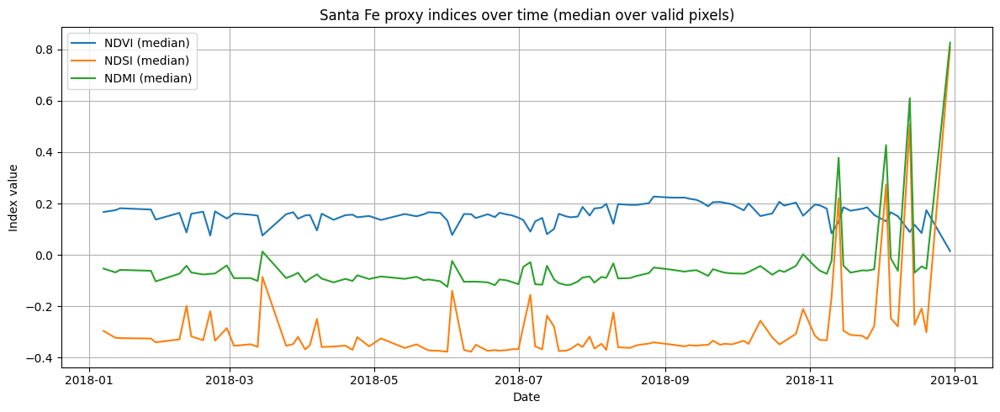

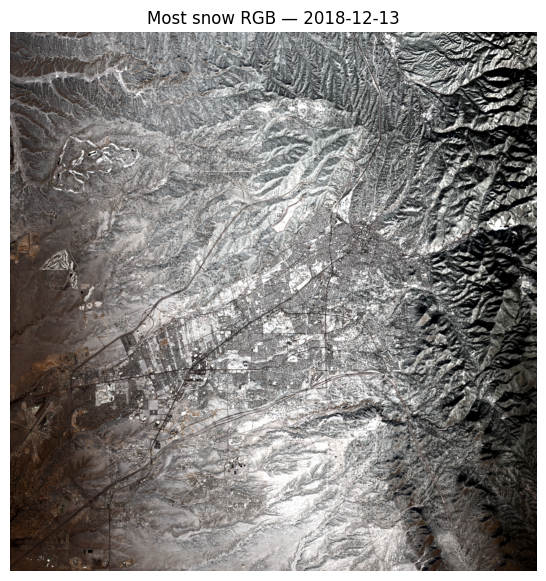

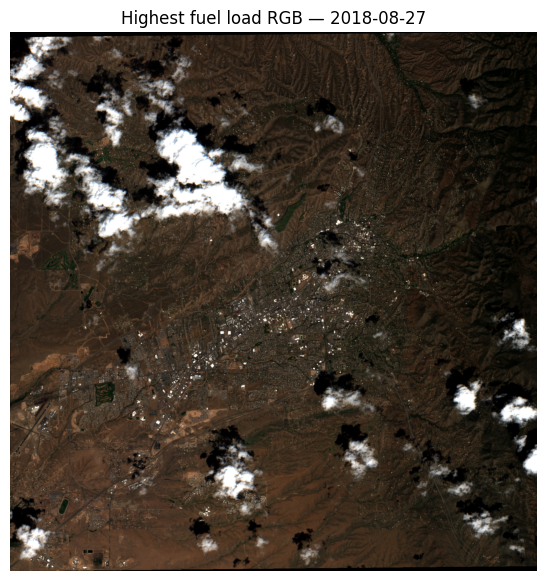

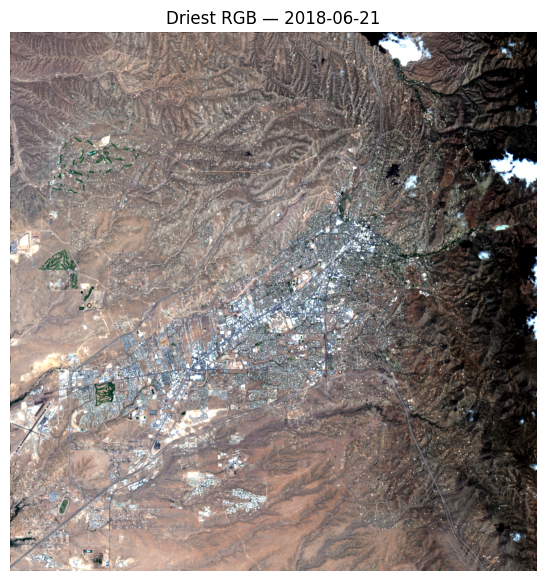

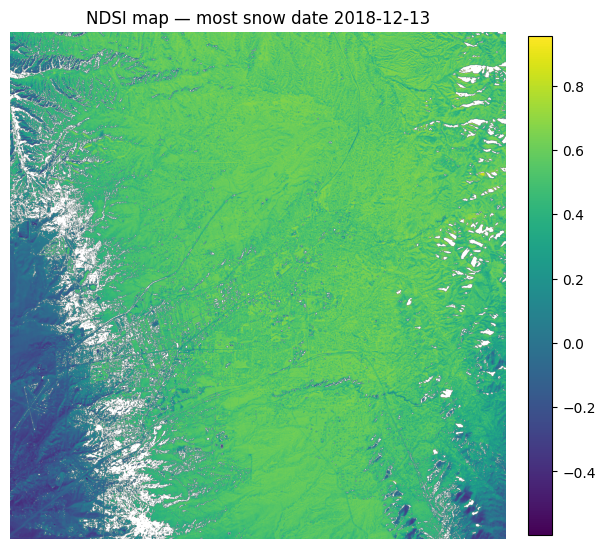

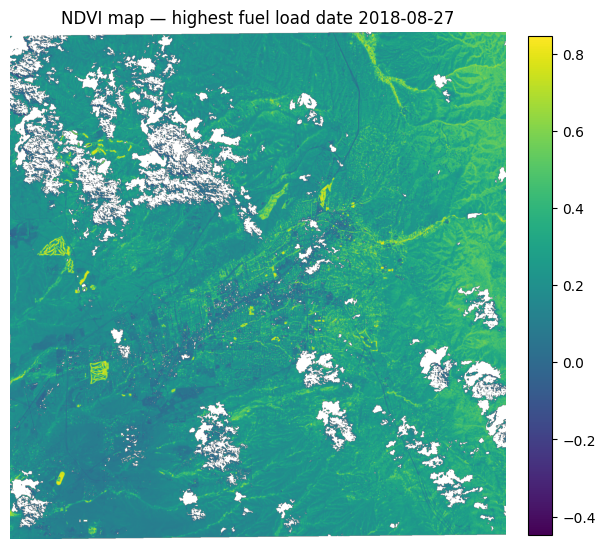

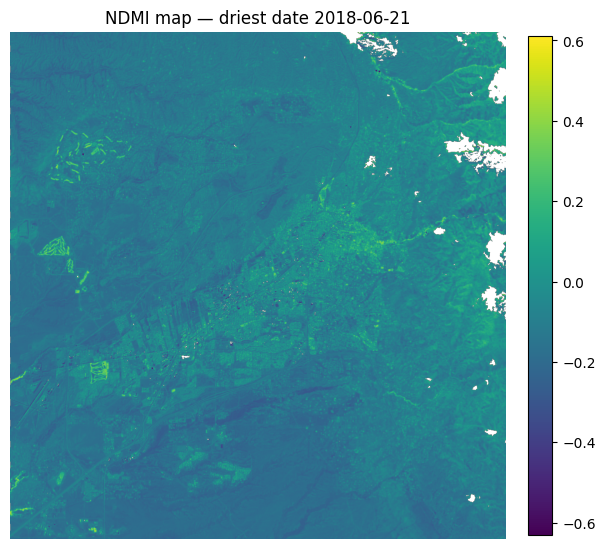

In [116]:
"""
If a satellite takes a picture, but 90% of Santa Fe is covered by a massive cloud,
the remaining 10% isn't a fair representation of the whole city. If that 10%
happens to be a snowy mountain peak, our algorithm might falsely declare it the
"Snowiest Day of the Year" for the entire region.

To fix this, we implement a strict quality filter: we only look for events
on days where the satellite had a clear view of at least 75% of the total area.
"""

# MIN_FOOTPRINT ensures the satellite orbital path actually covered the city (no half-black edges).
# MIN_CLEAR_TOTAL ensures those pixels aren't completely obscured by clouds.
MIN_FOOTPRINT = 0.90
MIN_CLEAR_TOTAL = 0.75

print(f"Scenes used (no coverage filter): {len(df)}")

# filter rows out that don't pass the minimum requirements
# (footprint must cover >= 90% of the frame, clear pixels must cover >= 75% of the frame)
df_good = df[
    (df["footprint_frac"] >= MIN_FOOTPRINT) &
    (df["clear_frac_total"] >= MIN_CLEAR_TOTAL)
].copy()

print(f"Scenes passing footprint+clear filter: {len(df_good)} / {len(df)}")
print(df_good[["date","footprint_frac","clear_frac_total","valid_frac"]].sort_values("date").head())

"""
Using our filtered, high-quality data table, we can instantly pinpoint the exact
dates for our target events.
"""

# using pandas idxmax/idxmin to find the row index of the highest/lowest values.
snow_row = df_good.loc[df_good["snow_frac"].idxmax()]
fuel_row = df_good.loc[df_good["ndvi_med"].idxmax()]
dry_row  = df_good.loc[df_good["ndmi_med"].idxmin()] # minimum Moisture = Driest Day

print("Most snow:", snow_row["date"].date(), "snow_frac:", snow_row["snow_frac"], "coverage:", snow_row["valid_frac"])
print("Highest fuel load:", fuel_row["date"].date(), "ndvi_med:", fuel_row["ndvi_med"], "coverage:", fuel_row["valid_frac"])
print("Driest:", dry_row["date"].date(), "ndmi_med:", dry_row["ndmi_med"], "coverage:", dry_row["valid_frac"])
# ---------------------------------------------------------------------

# I would like to thank Kristof Jablonowski for giving me the idea of a time series plot
# create time series plot
plt.figure(figsize=(12,5))
plt.plot(df["date"], df["ndvi_med"], label="NDVI (median)")
plt.plot(df["date"], df["ndsi_med"], label="NDSI (median)")
plt.plot(df["date"], df["ndmi_med"], label="NDMI (median)")
plt.title("Santa Fe proxy indices over time (median over valid pixels)")
plt.xlabel("Date")
plt.ylabel("Index value")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

# Helper function to visualize the remote sensing indices as a heat map.
# This provides geographic context to the median values we calculated above.
def show_index_map(img_path, mask_path, which="ndvi", title=""):
    with rasterio.open(img_path) as src:
        R = src.read(1).astype(np.float32)
        G = src.read(2).astype(np.float32)
        B = src.read(3).astype(np.float32)
        NIR = src.read(4).astype(np.float32)
        SWIR1 = src.read(5).astype(np.float32)
        alpha = src.read(7) > 0

    with rasterio.open(mask_path) as m:
        valid = (m.read(1) > 0) & alpha

    if which == "ndvi":
        idx = nd(NIR, R)
    elif which == "ndsi":
        idx = nd(G, SWIR1)
    elif which == "ndmi":
        idx = nd(NIR, SWIR1)
    else:
        raise ValueError("which must be one of: ndvi, ndsi, ndmi")

    # mask out invalid pixels with NaNs so they don't skew the heatmap colorbar
    idx_show = np.where(valid, idx, np.nan)

    plt.figure(figsize=(7,7))
    plt.imshow(idx_show)
    plt.axis("off")
    plt.title(title)
    plt.colorbar(fraction=0.046, pad=0.04)
    plt.show()

"""
Finally, we generate the actual maps for the three extreme dates we identified.
We show both the true-color "human eye" version, and the mathematical "index map"
that the computer sees.
"""

# show the three key RGB scenes
show_fixed_rgb(snow_row["img_path"], f"Most snow RGB — {snow_row['date'].date()}", contrast_stretch=True)
show_fixed_rgb(fuel_row["img_path"], f"Highest fuel load RGB — {fuel_row['date'].date()}", contrast_stretch=True)
show_fixed_rgb(dry_row["img_path"],  f"Driest RGB — {dry_row['date'].date()}", contrast_stretch=True)

# show corresponding index maps
show_index_map(snow_row["img_path"], snow_row["mask_path"], which="ndsi", title=f"NDSI map — most snow date {snow_row['date'].date()}")

show_index_map(fuel_row["img_path"], fuel_row["mask_path"], which="ndvi", title=f"NDVI map — highest fuel load date {fuel_row['date'].date()}")

show_index_map(dry_row["img_path"], dry_row["mask_path"], which="ndmi", title=f"NDMI map — driest date {dry_row['date'].date()}")

# Part 4

The government plans to use this digital initiative to foster tourism to Santa Fe and inspire awe about the high desert landscape.

To this end, the business client wants three specific maps to plaster on the walls inside city hall:

- The Toursim Map - "We need a picture of Santa Fe that looks like a sunny summer day, with zero clouds and no snow. It needs to look natural but beautiful."
- The Fire Risk Map - "We need a map that assumes the worst case scenario for biomass. It needs to show the absolute greenest point in every place across the year."
- The Ski Map - "Show us the maximum extent of the snowpack for the entire year on one image."

The business client expects ready-to-print maps for each of these scenarios. Once again, the technical client needs to be able to recreate these maps and possibly make more versions of them in the future.

In [118]:
import os, re
from glob import glob
import numpy as np
import rasterio
import matplotlib.pyplot as plt
from rasterio.warp import reproject, Resampling

DATA_DIR = "/content/drive/MyDrive/datasets/ece414_remote_sensing/s2_santafe_fixed_reproj"
MASK_DIR = "/content/drive/MyDrive/datasets/ece414_remote_sensing/s2_santafe_masks"
OUT_DIR = "/content/drive/MyDrive/datasets/ece414_remote_sensing/cityhall_maps"
os.makedirs(OUT_DIR, exist_ok=True)

tifs = sorted(glob(os.path.join(DATA_DIR, "*_fixed.tif")))

# reference grid from first scene (same as your mean code)
with rasterio.open(tifs[0]) as ref:
    ref_crs = ref.crs
    ref_transform = ref.transform
    ref_h, ref_w = ref.height, ref.width

print("Scenes:", len(tifs), "Ref shape:", (ref_h, ref_w))

Scenes: 102 Ref shape: (1719, 1680)


### Tourist Map

Summer scenes: 42


/tmp/ipython-input-4067026588.py:87: RuntimeWarning: All-NaN slice encountered
  tourism_R = np.nanmedian(all_r, axis=0)
/tmp/ipython-input-4067026588.py:88: RuntimeWarning: All-NaN slice encountered
  tourism_G = np.nanmedian(all_g, axis=0)
/tmp/ipython-input-4067026588.py:89: RuntimeWarning: All-NaN slice encountered
  tourism_B = np.nanmedian(all_b, axis=0)


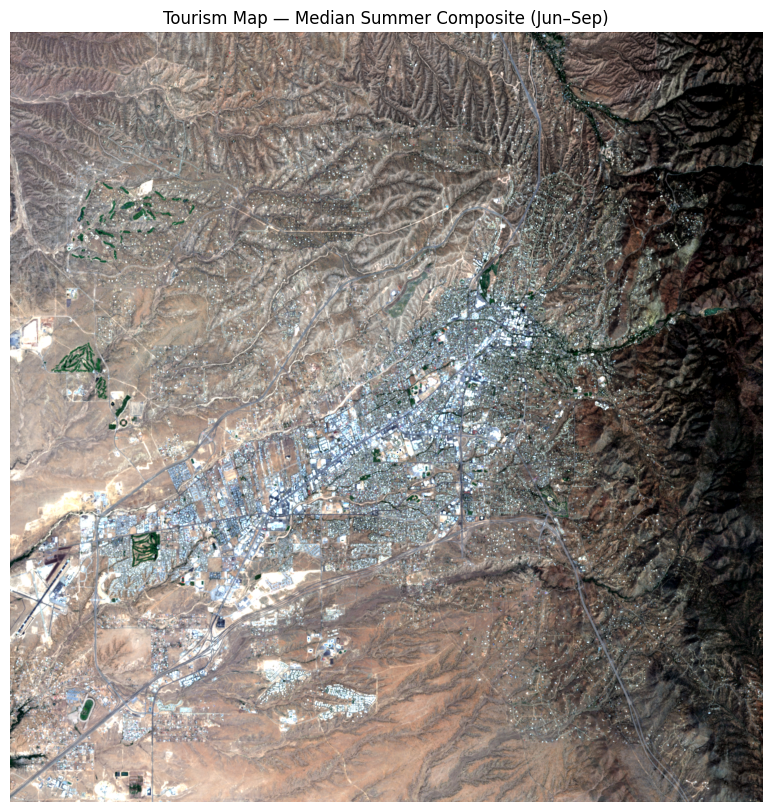

Tourism composite coverage: 100.0%


In [119]:
import os
import numpy as np
import rasterio
import matplotlib.pyplot as plt

"""
The city requested a map that looks like a flawless, sunny summer day with zero
clouds and no snow. However, finding a single day where the entire Santa Fe
region is perfectly clear is nearly impossible.

To solve this, we gather every picture taken during the summer months (June–September).
We throw out the clouds, the shadows, and any lingering mountain snow. Then,
we layer all these images on top of each other and calculate the "Median" color
for every single pixel. The result is a mathematically generated, pristine summer
day that perfectly represents the natural beauty of the landscape.
"""

# filter the dataset to only include peak summer months (June through September).
summer = []
for p_img in tifs:
    d = parse_date_from_name(p_img)
    if d.month < 6 or d.month > 9:
        continue
    p_m = os.path.join(MASK_DIR, os.path.basename(p_img).replace("_fixed.tif", "_validmask.tif"))
    if os.path.exists(p_m):
        summer.append((d, p_img, p_m))

print("Summer scenes:", len(summer))
if len(summer) == 0:
    raise RuntimeError("No summer scenes found with masks. Check tifs/MASK_DIR.")

# reference shape from first summer image
with rasterio.open(summer[0][1]) as ref:
    ref_h, ref_w = ref.height, ref.width

# Pre-allocate 3D arrays to hold our stacked summer images: (Time, Height, Width).
# We initialize with np.nan (Not a Number) instead of zeros. This ensures that
# when we calculate the median later, empty pixels are completely ignored rather
# than being calculated as "black" (0.0).
all_r = np.full((len(summer), ref_h, ref_w), np.nan, np.float32)
all_g = np.full((len(summer), ref_h, ref_w), np.nan, np.float32)
all_b = np.full((len(summer), ref_h, ref_w), np.nan, np.float32)
all_usable = np.zeros((len(summer), ref_h, ref_w), bool)

# reject scenes whose footprint covers too little of the frame
MIN_FOOTPRINT = 0.85

for i, (d, p_img, p_m) in enumerate(summer):
    with rasterio.open(p_img) as src:
        R = src.read(1).astype(np.float32)
        G = src.read(2).astype(np.float32)
        B = src.read(3).astype(np.float32)
        SWIR1 = src.read(5).astype(np.float32)
        alpha = (src.read(7) > 0)

    footprint_frac = float(alpha.mean())
    if footprint_frac < MIN_FOOTPRINT:
        continue

    with rasterio.open(p_m) as msrc:
        validmask = (msrc.read(1) > 0)

    valid = validmask & alpha

    # Tourism-specific heuristics.
    # The baseline validity mask is great, but for a "City Hall" tourism map,
    # we need to be extra aggressive. We recalculate strict snow and cloud thresholds
    # here to ensure absolutely zero white wisps make it into the final print.
    ndsi = nd(G, SWIR1)
    brightness = (R + G + B) / 3.0
    snow = (ndsi > 0.35) & (brightness > 0.20)

    # simple cloud proxy
    cloud = (brightness > 0.35) & (~snow)

    # a pixel is only usable if it's valid, not snow, and not a cloud.
    usable = valid & (~snow) & (~cloud)

    # Insert the usable pixels into our 3D stack. Unusable pixels remain as np.nan.
    all_r[i] = np.where(usable, R, np.nan)
    all_g[i] = np.where(usable, G, np.nan)
    all_b[i] = np.where(usable, B, np.nan)
    all_usable[i] = usable

# 'nanmedian' computes the median along the Time axis (axis=0), while completely
# ignoring the np.nan values. This collapses our 3D stack down into a single 2D "perfect" image.
tourism_R = np.nanmedian(all_r, axis=0)
tourism_G = np.nanmedian(all_g, axis=0)
tourism_B = np.nanmedian(all_b, axis=0)

# track which pixels had at least ONE valid observation across the entire summer
has_data = np.any(all_usable, axis=0)

# apply our global contrast stretch to make the colors pop
rgb_tourism = np.dstack([
    stretch(tourism_R, has_data),
    stretch(tourism_G, has_data),
    stretch(tourism_B, has_data),
])

"""
In standard satellite mapping, areas with no data are usually colored pure black.
However, since this map is being printed for City Hall, large black borders would
waste printer ink and look unappealing. We convert all "No-Data" areas to pure
white (1.0) so it blends cleanly onto a poster or document.
"""
# rgb_tourism is scaled 0.0 to 1.0. Setting to 1.0 makes no-data white.
rgb_tourism[~has_data] = 1.0

plt.figure(figsize=(10,10))
plt.imshow(rgb_tourism)
plt.axis("off")
plt.title("Tourism Map — Median Summer Composite (Jun–Sep)")
plt.show()

print(f"Tourism composite coverage: {100*has_data.mean():.1f}%")

### Fire Risk Map

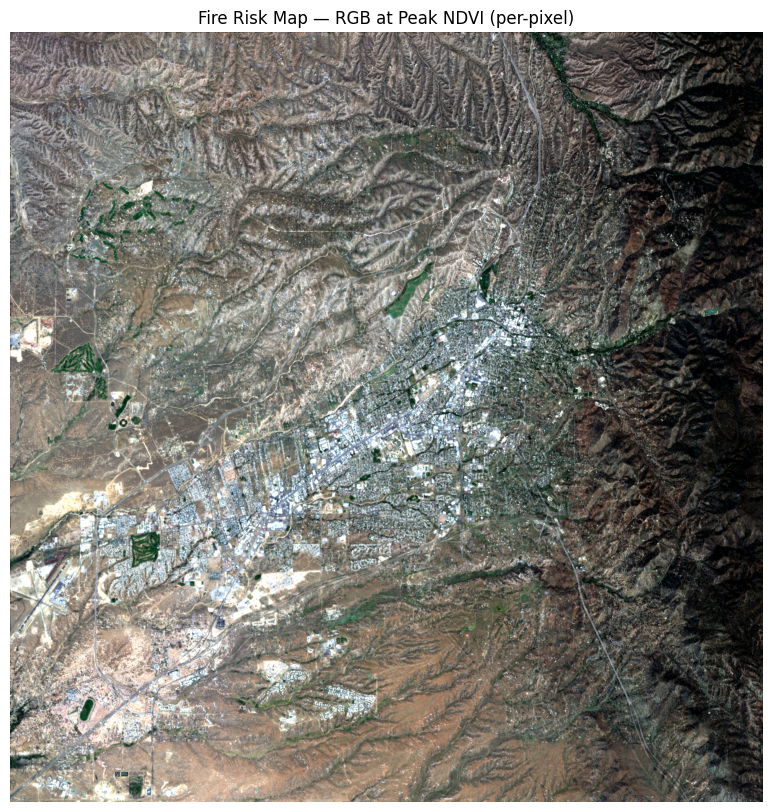

In [120]:
import os
import numpy as np
import rasterio
import matplotlib.pyplot as plt

"""
To understand wildfire risk, we need to know the maximum amount of "fuel" (plants,
brush, and trees) available to burn. However, plants peak at different times:
grasses might be greenest in May, while trees peak in August.

To map the absolute worst-case scenario, we use a "Greenest Pixel" technique.
The computer scans the entire summer dataset. For every single spot on the ground,
it finds the exact day that specific spot was at its absolute greenest, and cuts
out that pixel. It then stitches all these "peak green" pixels together into a
single, worst-case mosaic.
"""

# initialize from any one image (all same shape now)
with rasterio.open(tifs[0]) as ref:
    ref_h, ref_w = ref.height, ref.width

# we initialize the maximum NDVI tracking array with a very low
# number (-999.0) so that the very first valid observation will immediately override it.
max_ndvi = np.full((ref_h, ref_w), -999.0, np.float32)

# arrays to hold the exact Red, Green, and Blue values of the pixel on its "greenest" day.
fire_rgb = np.zeros((ref_h, ref_w, 3), np.float32)

# a boolean mask to track whether a pixel has EVER successfully recorded a valid vegetation observation.
has_fire = np.zeros((ref_h, ref_w), bool)

# Restrict our search to the primary growing season (May through September)
# to avoid winter anomalies or false vegetation signals from late-season snowmelt.
veg_months = {5, 6, 7, 8, 9}

for p_img in tifs:
    d = parse_date_from_name(p_img)
    if d.month not in veg_months:
        continue

    p_m = os.path.join(MASK_DIR, os.path.basename(p_img).replace("_fixed.tif", "_validmask.tif"))
    if not os.path.exists(p_m):
        continue

    with rasterio.open(p_img) as src:
        R = src.read(1).astype(np.float32)
        G = src.read(2).astype(np.float32)
        B = src.read(3).astype(np.float32)
        NIR = src.read(4).astype(np.float32)
        SWIR1 = src.read(5).astype(np.float32)
        alpha = (src.read(7) > 0)

    with rasterio.open(p_m) as msrc:
        validmask = (msrc.read(1) > 0)

    valid = validmask & alpha

    # exclude snow + simple cloud proxy
    ndsi = nd(G, SWIR1)
    brightness = (R + G + B) / 3.0
    snow = (ndsi > 0.30) & (brightness > 0.20)
    cloud = (brightness > 0.35) & (~snow)

    # calculate standard NDVI for the current scene.
    ndvi = nd(NIR, R)

    # true vegetation strongly reflects NIR but absorbs blue light.
    # this prevents highly reflective artificial surfaces (like blue roofs or solar panels)
    # from accidentally registering as "peak vegetation".
    looks_like_veg = NIR > (B * 1.5)

    # a pixel is eligible if it is valid, not snow, not a cloud, and passes the basic vegetation check.
    usable = valid & (~snow) & (~cloud) & looks_like_veg

    # we create a boolean array 'better' that is true ONLY if the pixel is usable
    # AND its current NDVI is strictly greater than the historical running maximum.
    better = usable & (ndvi > max_ndvi)

    # if the current day is 'better' (greener), overwrite the running records!
    max_ndvi[better] = ndvi[better]
    fire_rgb[better, 0] = R[better]
    fire_rgb[better, 1] = G[better]
    fire_rgb[better, 2] = B[better]
    has_fire |= better

"""
Because we are only tracking areas with actual vegetation, roads, lakes, and
barren dirt might end up as empty black holes on our map. To make the map
aesthetically pleasing for the wall, we take those empty gaps and seamlessly
fill them in using the background from our beautiful Tourism Map.
"""

# fill gaps with tourism composite to avoid holes
# 'gaps' identifies pixels that never registered any vegetation (has_fire is False)
# BUT do have valid background data in the tourism median composite.
gaps = (~has_fire) & (np.isfinite(tourism_R))
fire_rgb[gaps, 0] = tourism_R[gaps]
fire_rgb[gaps, 1] = tourism_G[gaps]
fire_rgb[gaps, 2] = tourism_B[gaps]
has_fire |= gaps

# stretch for display using our previously defined global stretch function
fire_vis = np.dstack([
    stretch(fire_rgb[:, :, 0], has_fire),
    stretch(fire_rgb[:, :, 1], has_fire),
    stretch(fire_rgb[:, :, 2], has_fire),
])

# set any remaining absolute No-Data areas to pure white (same logic as tourism map)
fire_vis[~has_fire] = 1.0

plt.figure(figsize=(10,10))
plt.imshow(fire_vis)
plt.axis("off")
plt.title("Fire Risk Map — RGB at Peak NDVI (per-pixel)")
plt.show()

### Ski Map

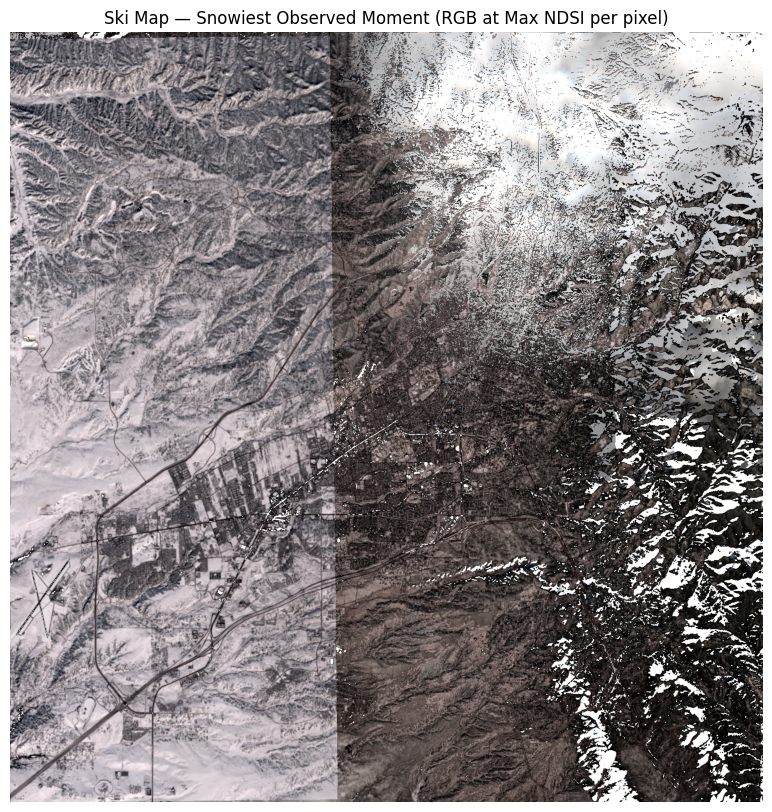

In [121]:
import os
import numpy as np
import rasterio
import matplotlib.pyplot as plt

"""
The final request for City Hall is a map showing the maximum extent of the
snowpack for the entire year on one image. Because snow melts and falls at
different rates depending on elevation, there is no single day where the snow
is at its absolute peak everywhere.

To solve this, we use the same "Maximum Value Composite" technique as the Fire
Risk map, but optimized for winter conditions. The algorithm scans the entire year,
finds the exact day every individual pixel was at its absolute snowiest, and stitches
them together. This creates a comprehensive map of every inch of the Santa Fe region
that received significant snow.
"""

with rasterio.open(tifs[0]) as ref:
    ref_h, ref_w = ref.height, ref.width

# snow_any tracks if a pixel EVER saw snow during the year.
# snow_count tracks the FREQUENCY of snow (how many days it was snow-covered),
# which is excellent for prolonged snowpack analysis.
snow_any = np.zeros((ref_h, ref_w), dtype=bool)
snow_count = np.zeros((ref_h, ref_w), dtype=np.uint16)

# initialize max_ndsi at -999.0 so the first valid snow observation overrides it.
max_ndsi = np.full((ref_h, ref_w), -999.0, dtype=np.float32)

# array to hold the True Color (RGB) values of the pixel on its snowiest day.
snow_rgb = np.zeros((ref_h, ref_w, 3), dtype=np.float32)

for p_img in tifs:
    p_m = os.path.join(MASK_DIR, os.path.basename(p_img).replace("_fixed.tif", "_validmask.tif"))
    if not os.path.exists(p_m):
        continue

    with rasterio.open(p_img) as src:
        R = src.read(1).astype(np.float32)
        G = src.read(2).astype(np.float32)
        B = src.read(3).astype(np.float32)

        # SWIR1 is critical here because snow strongly absorbs SWIR light,
        # allowing us to separate it mathematically from bright white clouds.
        SWIR1 = src.read(5).astype(np.float32)
        alpha = (src.read(7) > 0)

    with rasterio.open(p_m) as msrc:
        validmask = (msrc.read(1) > 0)

    # a pixel must be marked as valid by our cloud/shadow heuristic mask AND be inside the footprint.
    valid = validmask & alpha

    # calculate the Normalized Difference Snow Index (NDSI) and general brightness.
    ndsi = nd(G, SWIR1)
    brightness = (R + G + B) / 3.0

    # high NDSI + High Brightness confirms it is snow, not just a cold/dark mountain peak.
    snow = valid & (ndsi > 0.35) & (brightness > 0.20)

    # Log the occurrence of snow for this day into our historical trackers
    # |= is the bitwise OR assignment (if it was ever True, it stays True)
    snow_any |= snow
    snow_count += snow.astype(np.uint16)

    # If the pixel is confirmed as snow today, AND today's NDSI is higher than the
    # historical record overwrite the record with today's values!
    better = snow & (ndsi > max_ndsi)
    max_ndsi[better] = ndsi[better]
    snow_rgb[better, 0] = R[better]
    snow_rgb[better, 1] = G[better]
    snow_rgb[better, 2] = B[better]

"""
Because we pulled pixels from dozens of different days across the year, you might
notice slight "seams" or differences in lighting across the map. This is normal
for a maximum-extent composite. Finally, we set all non-snow areas to white to
create a clean, print-ready document.
"""

# only apply the stretch to pixels that recorded snow at least once.
has_rgb = max_ndsi > -999

snow_rgb_vis = np.dstack([
    stretch(snow_rgb[:, :, 0], has_rgb),
    stretch(snow_rgb[:, :, 1], has_rgb),
    stretch(snow_rgb[:, :, 2], has_rgb),
])
# just like the previous maps, set all areas that never saw snow to pure white.
snow_rgb_vis[~has_rgb] = 1.0

plt.figure(figsize=(10,10))
plt.imshow(snow_rgb_vis)
plt.axis("off")
plt.title("Ski Map — Snowiest Observed Moment (RGB at Max NDSI per pixel)")
plt.show()

"""
FOR BUSINESS PERSON:
You may notice a faint "rectangle" or seam in the final snow map where the brightness
shifts suddenly. Because this map is a mosaic built from different days throughout
the year, the lighting is never perfectly uniform. Different days have varying sun
angles, atmospheric haze, and shadows. We attempted to digitally normalize the
lighting, but this patchwork effect is a standard limitation of maximum-value
satellite composites. The underlying data is still 100% valid and accurate!

FOR TECHNICAL PERSON:
The "big rectangle" brightness artifact happens because different pixels come from
different dates with different illumination/haze.

To mitigate this, I implemented a normalization prepass to compute a
GLOBAL_TARGET brightness (the median of per-scene brightness medians over a stable
reference region). A per-scene scaling (scale = GLOBAL_TARGET/scene_med) was
then applied and clamped between 0.85 and 1.20 to avoid tiles going too dark or
bright before storing the normalized RGB for the winning pixels. Despite this,
the seams remain visible due to the extreme contrast of snow against
varied lighting conditions. Thus, I reverted the code back to the original
version without the normalization.
"""